# 02 — EDA & Mapping
Load processed geodata, compute spatial weights, run LISA, and export figures and interactive maps.

In [7]:
import geopandas
import pandas as pd
import folium

In [3]:
powerplant = pd.read_csv(r'C:\Users\gbles\Documents\Github\Spatial Analysis\Spatial-Analysis\data\raw\Adjusted Power Plant.csv')
powerplant.head(4)

,Unnamed: 0,Plant_Name,Utility_Na,sector_nam,Street_Add,City,County,State,Zip,PrimSource,source_des,tech_desc,Install_MW,Total_MW,Source,Period,Longitude,Latitude,Fuel Type
0,0,Sand Point,"Sand Point Generating, LLC",Electric Utility,100 Power Plant Way,Sand Point,Aleutians East,Alaska,99661.0,petroleum,"Petroleum = 1.3 MW, Wind = 0.4 MW",Petroleum Liquids; Onshore Wind Turbine;,3.7,1.7,"EIA-860, EIA-860M and EIA-923",202406,-160.497222,55.339722,Fossil Fuel
1,1,Bankhead Dam,Alabama Power Co,Electric Utility,19001 Lock 17 Road,Northport,Tuscaloosa,Alabama,35476.0,hydroelectric,Hydroelectric = 53 MW,Conventional Hydroelectric,53.9,53.0,"EIA-860, EIA-860M and EIA-923",202406,-87.356823,33.458665,Clean Energy
2,2,Barry,Alabama Power Co,Electric Utility,North Highway 43,Bucks,Mobile,Alabama,36512.0,natural gas,"Coal = 1118.5 MW, Natural Gas = 1981.2 MW",Conventional Steam Coal; Natural Gas Fired Com...,3343.5,3099.7,"EIA-860, EIA-860M and EIA-923",202406,-88.010300,31.006900,Fossil Fuel
3,3,Walter Bouldin Dam,Alabama Power Co,Electric Utility,750 Bouldin Dam Road,Wetumpka,Elmore,Alabama,36092.0,hydroelectric,Hydroelectric = 224.1 MW,Conventional Hydroelectric,225.0,224.1,"EIA-860, EIA-860M and EIA-923",202406,-86.283056,32.583889,Clean Energy


In [11]:
Cal_census = geopandas.read_file(r"C:\Users\gbles\Documents\Github\Spatial Analysis\Spatial-Analysis\data\raw\Cali_counties.shp")

In [12]:
Cal_census.explore()

In [4]:
geometry = geopandas.points_from_xy(x=powerplant['Longitude'], y=powerplant['Latitude'])

In [17]:
geometry

<GeometryArray>
[ <POINT (-160.497 55.34)>,  <POINT (-87.357 33.459)>,
   <POINT (-88.01 31.007)>,  <POINT (-86.283 32.584)>,
 <POINT (-106.375 31.757)>,  <POINT (-87.781 32.602)>,
  <POINT (-86.052 33.784)>,   <POINT (-87.45 33.255)>,
  <POINT (-86.255 32.619)>,  <POINT (-86.338 33.426)>,
 ...
  <POINT (-74.191 40.684)>,  <POINT (-74.191 40.684)>,
  <POINT (-74.191 40.684)>,  <POINT (-74.191 40.684)>,
  <POINT (-89.864 41.759)>,   <POINT (-89.867 41.76)>,
  <POINT (-88.473 43.734)>, <POINT (-110.914 32.125)>,
 <POINT (-112.178 33.418)>, <POINT (-115.082 36.251)>]
Length: 12798, dtype: geometry

In [5]:
gdf = geopandas.GeoDataFrame(powerplant, geometry=geometry, crs='EPSG:4326')

In [19]:
gdf

,Unnamed: 0,Plant_Name,Utility_Na,sector_nam,Street_Add,City,County,State,Zip,PrimSource,source_des,tech_desc,Install_MW,Total_MW,Source,Period,Longitude,Latitude,Fuel Type,geometry
0,0,Sand Point,"Sand Point Generating, LLC",Electric Utility,100 Power Plant Way,Sand Point,Aleutians East,Alaska,99661.0,petroleum,"Petroleum = 1.3 MW, Wind = 0.4 MW",Petroleum Liquids; Onshore Wind Turbine;,3.7,1.7,"EIA-860, EIA-860M and EIA-923",202406,-160.497222,55.339722,Fossil Fuel,POINT (-160.49722 55.33972)
1,1,Bankhead Dam,Alabama Power Co,Electric Utility,19001 Lock 17 Road,Northport,Tuscaloosa,Alabama,35476.0,hydroelectric,Hydroelectric = 53 MW,Conventional Hydroelectric,53.9,53.0,"EIA-860, EIA-860M and EIA-923",202406,-87.356823,33.458665,Clean Energy,POINT (-87.35682 33.45866)
2,2,Barry,Alabama Power Co,Electric Utility,North Highway 43,Bucks,Mobile,Alabama,36512.0,natural gas,"Coal = 1118.5 MW, Natural Gas = 1981.2 MW",Conventional Steam Coal; Natural Gas Fired Com...,3343.5,3099.7,"EIA-860, EIA-860M and EIA-923",202406,-88.010300,31.006900,Fossil Fuel,POINT (-88.0103 31.0069)
3,3,Walter Bouldin Dam,Alabama Power Co,Electric Utility,750 Bouldin Dam Road,Wetumpka,Elmore,Alabama,36092.0,hydroelectric,Hydroelectric = 224.1 MW,Conventional Hydroelectric,225.0,224.1,"EIA-860, EIA-860M and EIA-923",202406,-86.283056,32.583889,Clean Energy,POINT (-86.28306 32.58389)
4,4,Copper,El Paso Electric Co,Electric Utility,651 Hawkins Blvd.,El Paso,El Paso,Texas,79915.0,natural gas,Natural Gas = 63 MW,Natural Gas Fired Combustion Turbine,86.9,63.0,"EIA-860, EIA-860M and EIA-923",202406,-106.375000,31.756900,Fossil Fuel,POINT (-106.375 31.7569)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12793,12793,Round Grove 2,SoCore Energy LLC,IPP Non-CHP,12213 Yorktown Road,Lyndon,Whiteside,Illinois,61261.0,solar,Solar = 2 MW,Solar Photovoltaic,2.0,2.0,"EIA-860, EIA-860M and EIA-923",202406,-89.867000,41.760000,Clean Energy,POINT (-89.867 41.76)
12794,12794,Fond du Lac Community Solar,SoCore Energy LLC,IPP Non-CHP,TBD,Fond Du Lac,Fond Du Lac,Wisconsin,78719.0,solar,Solar = 1 MW,Solar Photovoltaic,1.0,1.0,"EIA-860, EIA-860M and EIA-923",202406,-88.473000,43.734000,Clean Energy,POINT (-88.473 43.734)
12795,12795,TJX Tucson,SoCore Energy LLC,IPP Non-CHP,7000 S Alvernon Way,Tucson,Pima,Arizona,85756.0,solar,Solar = 1 MW,Solar Photovoltaic,1.0,1.0,"EIA-860, EIA-860M and EIA-923",202406,-110.913919,32.125000,Clean Energy,POINT (-110.91392 32.125)
12796,12796,TJX Phoenix,SoCore Energy LLC,IPP Non-CHP,3000 S. 55th Avenue,Phoenix,Maricopa,Arizona,85043.0,solar,Solar = 2.9 MW,Solar Photovoltaic,2.9,2.9,"EIA-860, EIA-860M and EIA-923",202406,-112.178067,33.418481,Clean Energy,POINT (-112.17807 33.41848)


In [13]:
powerplant_map = gdf.explore(column="Fuel Type",  # make choropleth based on "BoroName" column
    tooltip="Fuel Type",  # show "BoroName" value in tooltip (on hover)
    popup=True,  # show all values in popup (on click)
    tiles="CartoDB positron",  # use "CartoDB positron" tiles
    cmap="Set1",  # use "Set1" matplotlib colormap
    style_kwds=dict(color="black"))

Cal_census.explore(
    m=powerplant_map,  # pass the map object
    color="red",  # use red color on all points
    marker_kwds=dict(radius=5, fill=True),  # make marker radius 10px with fill
    tooltip="NAMELSAD",  # show "name" column in the tooltip
    tooltip_kwds=dict(labels=False),  # do not show column label in the tooltip
    name="California Census Tracts",  # name of the layer in the map
)

folium.TileLayer("CartoDB positron", show=False).add_to(
    powerplant_map
)  # use folium to add alternative tiles
folium.LayerControl().add_to(powerplant_map)  # use folium to add layer control

powerplant_map  # show map

C:\Users\gbles\AppData\Local\Temp\ipykernel_28932\2483214966.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf["centroid"] = gdf.geometry.centroid


<Axes: >

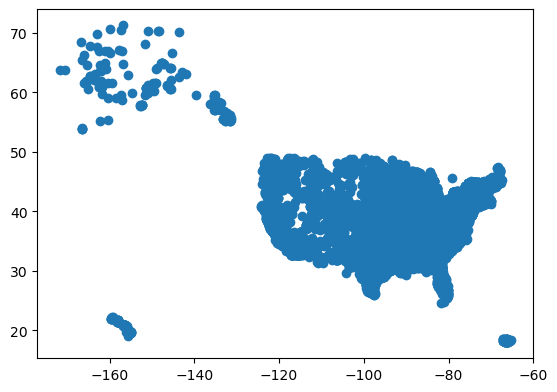

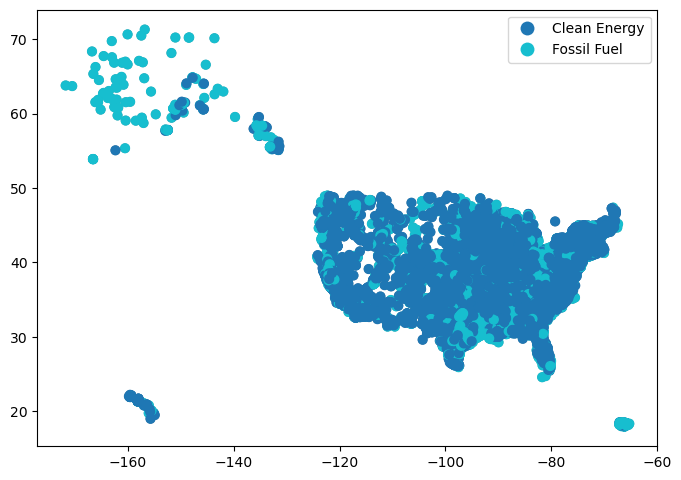

In [ ]:
ax = gdf["geometry"].plot()
# Suppose gdf is your GeoDataFrame with polygons
gdf["centroid"] = gdf.geometry.centroid
ax = gdf.geometry.plot(figsize=(8,8), edgecolor="gray", facecolor="none")

gdf.plot(
    ax=ax,
    column="Fuel Type",   # <-- categorical or numeric variable
    markersize=40,
    legend=True
)